In [2]:
import numpy as np

In [6]:
import matplotlib.pyplot as plt

In [10]:
import pandas as pd
import seaborn as sns
import plotly as py

In [12]:
df = pd.read_csv("Bike.csv")

In [14]:
df.head()

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,member_birth_year,member_gender,bike_share_for_all_trip
0,75284,2018-01-31 22:52:35.2390,2018-02-01 19:47:19.8240,120,Mission Dolores Park,37.761420,-122.426435,285,Webster St at O'Farrell St,37.783521,-122.431158,2765,Subscriber,1986.0,Male,No
1,85422,2018-01-31 16:13:34.3510,2018-02-01 15:57:17.3100,15,San Francisco Ferry Building (Harry Bridges Pl...,37.795392,-122.394203,15,San Francisco Ferry Building (Harry Bridges Pl...,37.795392,-122.394203,2815,Customer,NaN,NaN,No
2,71576,2018-01-31 14:23:55.8890,2018-02-01 10:16:52.1160,304,Jackson St at 5th St,37.348759,-121.894798,296,5th St at Virginia St,37.325998,-121.877120,3039,Customer,1996.0,Male,No
3,61076,2018-01-31 14:53:23.5620,2018-02-01 07:51:20.5000,75,Market St at Franklin St,37.773793,-122.421239,47,4th St at Harrison St,37.780955,-122.399749,321,Customer,NaN,NaN,No
4,39966,2018-01-31 19:52:24.6670,2018-02-01 06:58:31.0530,74,Laguna St at Hayes St,37.776435,-122.426244,19,Post St at Kearny St,37.788975,-122.403452,617,Subscriber,1991.0,Male,No


In [16]:
df.info

<bound method DataFrame.info of        duration_sec                start_time                  end_time  \
0             75284  2018-01-31 22:52:35.2390  2018-02-01 19:47:19.8240   
1             85422  2018-01-31 16:13:34.3510  2018-02-01 15:57:17.3100   
2             71576  2018-01-31 14:23:55.8890  2018-02-01 10:16:52.1160   
3             61076  2018-01-31 14:53:23.5620  2018-02-01 07:51:20.5000   
4             39966  2018-01-31 19:52:24.6670  2018-02-01 06:58:31.0530   
...             ...                       ...                       ...   
94797           695  2018-01-01 00:19:58.7610  2018-01-01 00:31:33.8320   
94798           600  2018-01-01 00:19:48.7610  2018-01-01 00:29:49.0740   
94799          1151  2018-01-01 00:09:31.7450  2018-01-01 00:28:43.1590   
94800           714  2018-01-01 00:07:52.9430  2018-01-01 00:19:47.0750   
94801           145  2018-01-01 00:07:41.0400  2018-01-01 00:10:06.2410   

       start_station_id                                 start_stati

In [18]:
df.shape

(94802, 16)

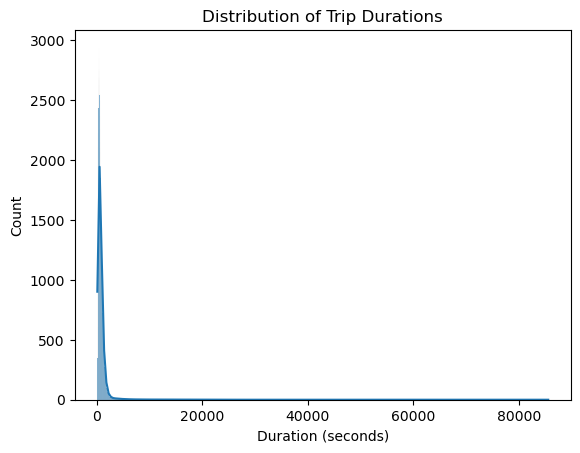

In [20]:
sns.histplot(df['duration_sec'], kde=True)
plt.title('Distribution of Trip Durations')
plt.xlabel('Duration (seconds)')
plt.show()

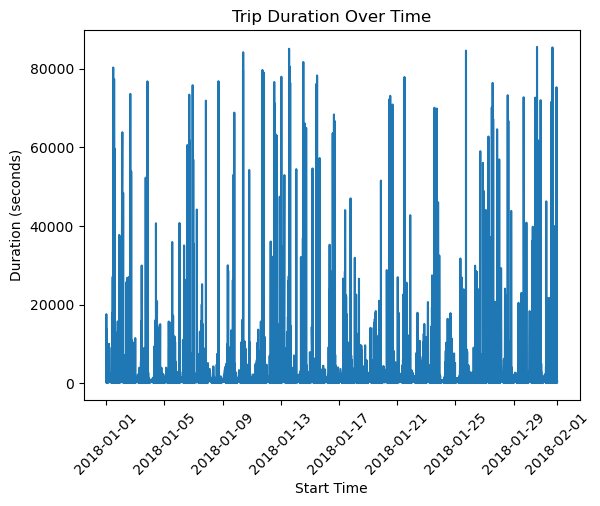

In [24]:
df['start_time'] = pd.to_datetime(df['start_time'])
df.sort_values('start_time', inplace=True)

plt.plot(df['start_time'], df['duration_sec'])
plt.title('Trip Duration Over Time')
plt.xlabel('Start Time')
plt.xticks(rotation=45)
plt.ylabel('Duration (seconds)')
plt.show()

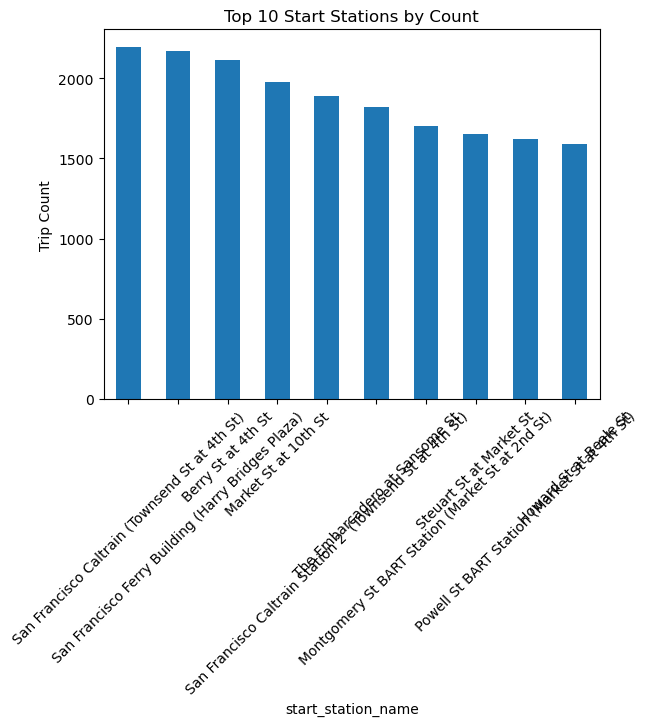

In [26]:
df['start_station_name'].value_counts().head(10).plot(kind='bar')
plt.title('Top 10 Start Stations by Count')
plt.ylabel('Trip Count')
plt.xticks(rotation=45)
plt.show()

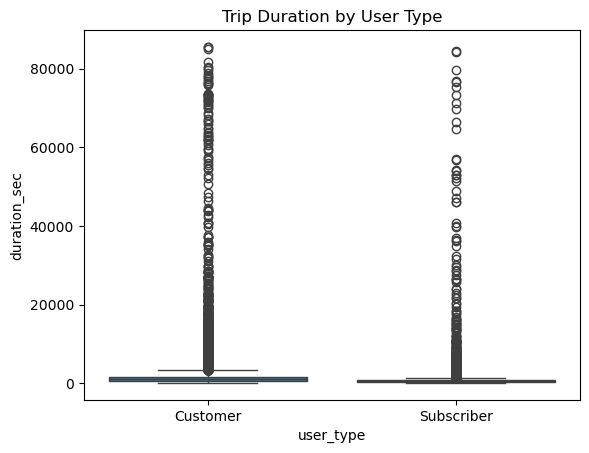

In [28]:
sns.boxplot(x='user_type', y='duration_sec', data=df)
plt.title('Trip Duration by User Type')
plt.show()

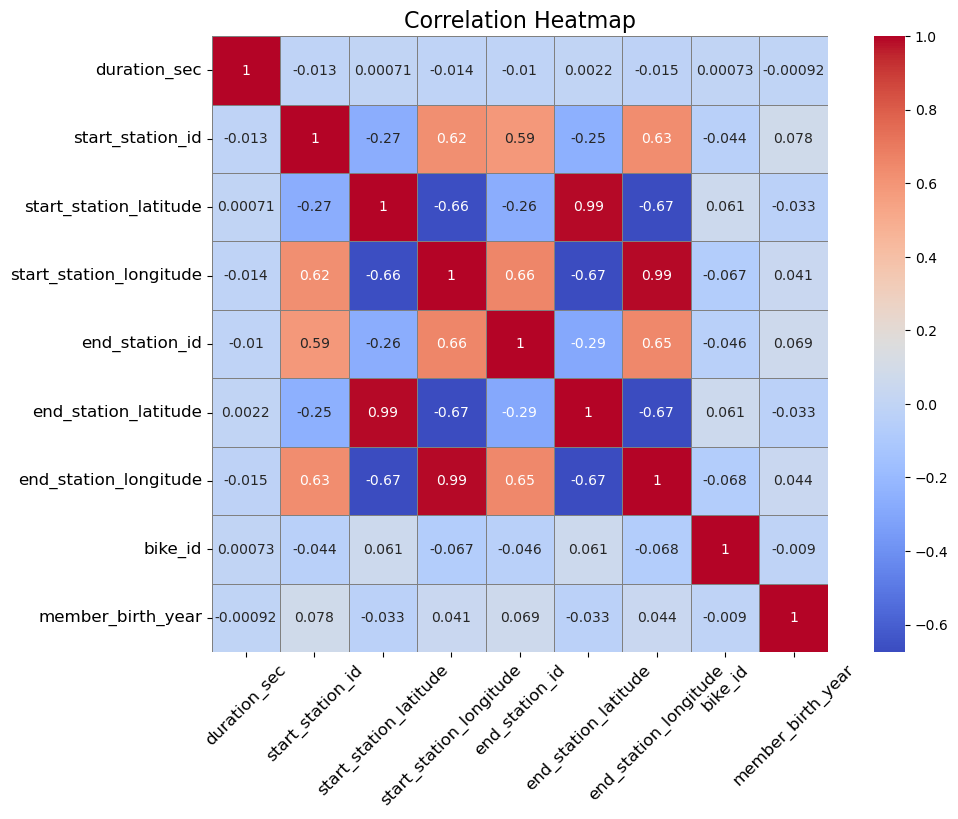

In [54]:
plt.figure(figsize=(12, 8))
sns.heatmap(df.corr(numeric_only=True), annot=True, cmap='coolwarm', linewidths=0.5, linecolor='gray', square=True)
plt.title('Correlation Heatmap', fontsize=16)
plt.xticks(fontsize=12, rotation=45)
plt.yticks(fontsize=12, rotation=0)
plt.show()

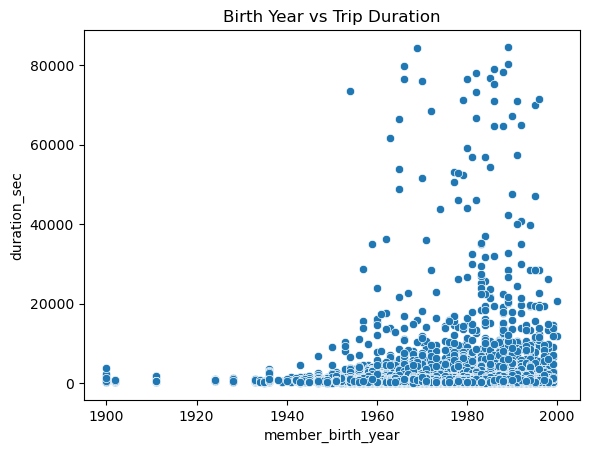

In [32]:
sns.scatterplot(x='member_birth_year', y='duration_sec', data=df)
plt.title('Birth Year vs Trip Duration')
plt.show()

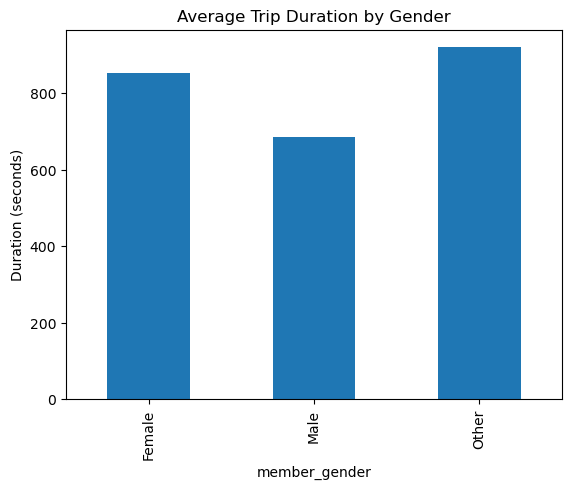

In [34]:
df.groupby('member_gender')['duration_sec'].mean().plot(kind='bar')
plt.title('Average Trip Duration by Gender')
plt.ylabel('Duration (seconds)')
plt.show()

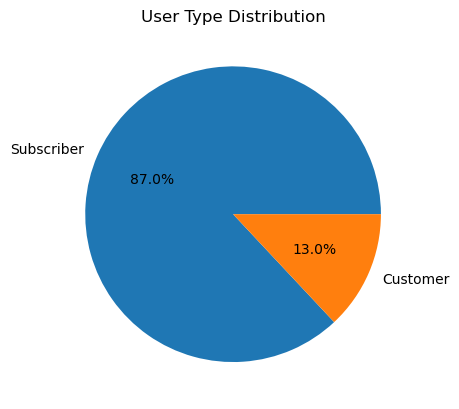

In [36]:
df['user_type'].value_counts().plot.pie(autopct='%1.1f%%')
plt.title('User Type Distribution')
plt.ylabel('')
plt.show()

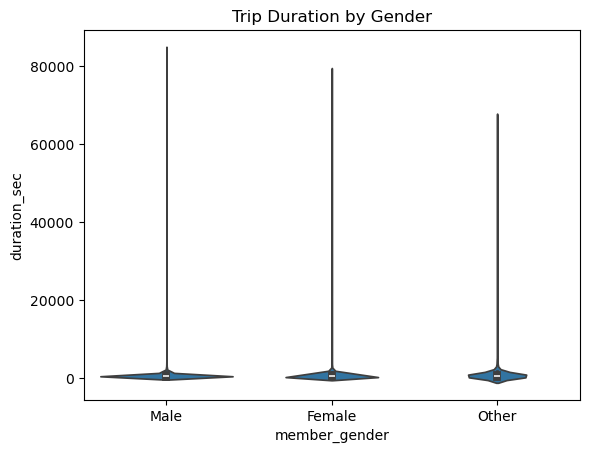

In [42]:
sns.violinplot(x='member_gender', y='duration_sec', data=df)
plt.title('Trip Duration by Gender')
plt.show()

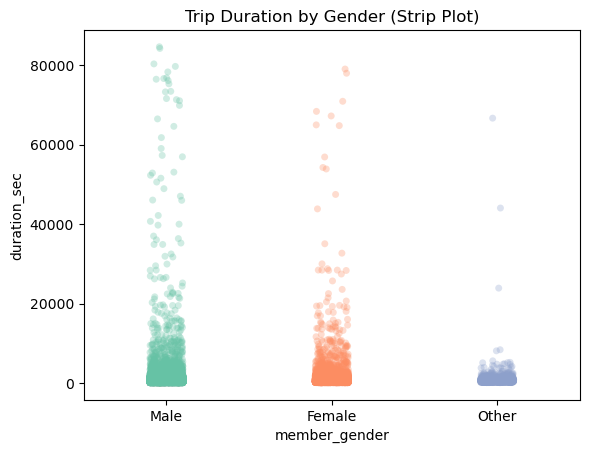

In [62]:
sns.stripplot(x='member_gender', y='duration_sec', data=df, hue='member_gender', 
              jitter=True, alpha=0.3, palette='Set2', legend=False)
plt.title('Trip Duration by Gender (Strip Plot)')
plt.show()

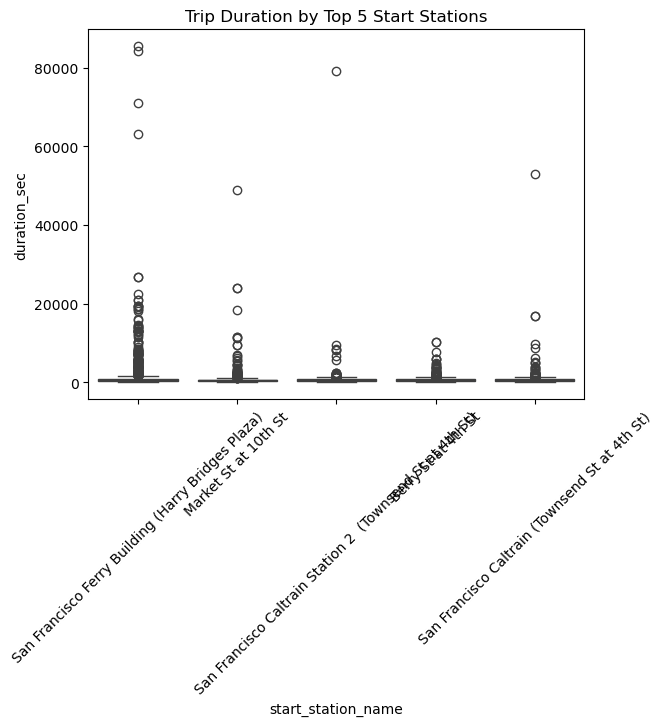

In [44]:
top_stations = df['start_station_name'].value_counts().nlargest(5).index
sns.boxplot(x='start_station_name', y='duration_sec', data=df[df['start_station_name'].isin(top_stations)])
plt.title('Trip Duration by Top 5 Start Stations')
plt.xticks(rotation=45)
plt.show()

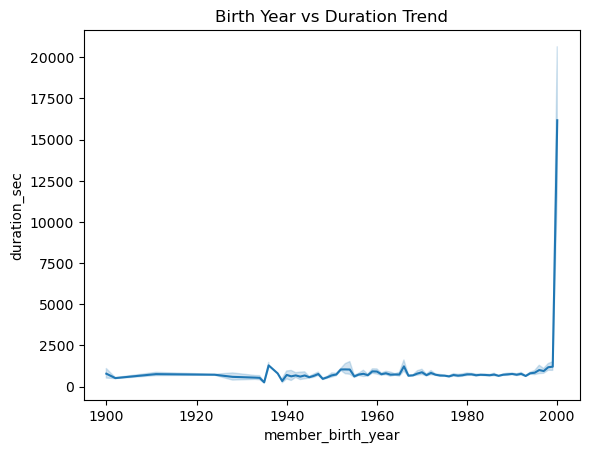

In [46]:
sns.lineplot(x='member_birth_year', y='duration_sec', data=df)
plt.title('Birth Year vs Duration Trend')
plt.show()

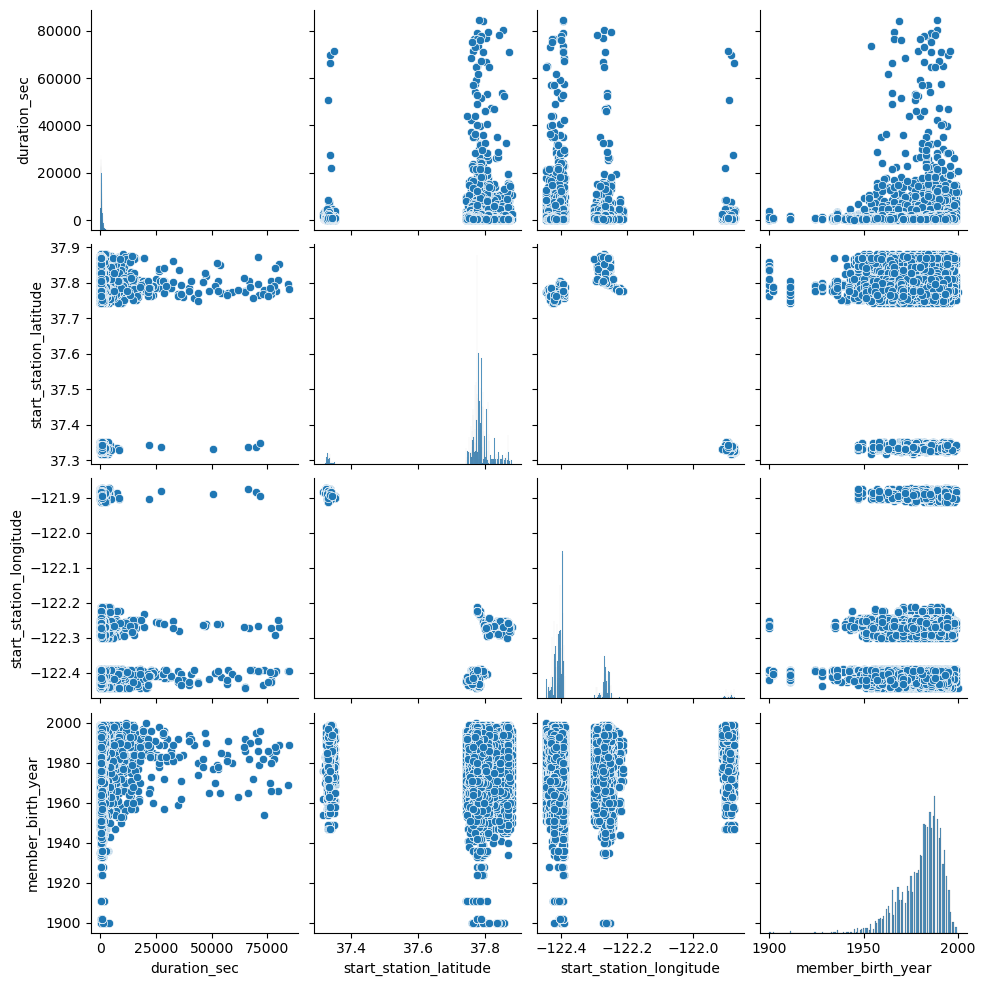

In [48]:
sns.pairplot(df[['duration_sec', 'start_station_latitude', 'start_station_longitude', 'member_birth_year']].dropna())
plt.show()

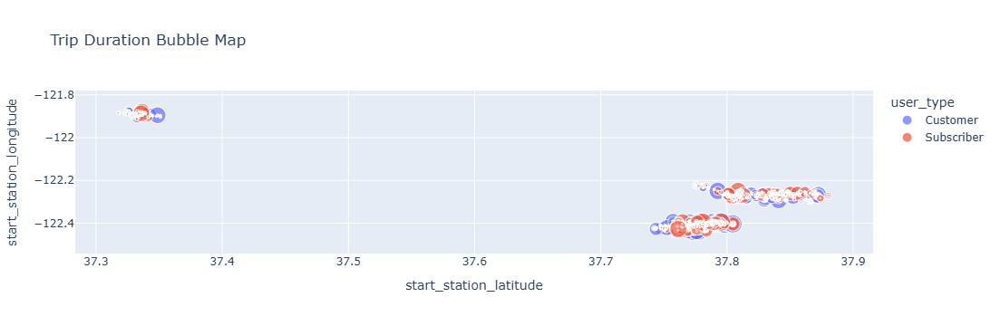

In [50]:
import plotly.express as px

fig = px.scatter(df, 
                 x='start_station_latitude', 
                 y='start_station_longitude', 
                 size='duration_sec', 
                 color='user_type', 
                 hover_name='start_station_name',
                 title='Trip Duration Bubble Map')
fig.show()

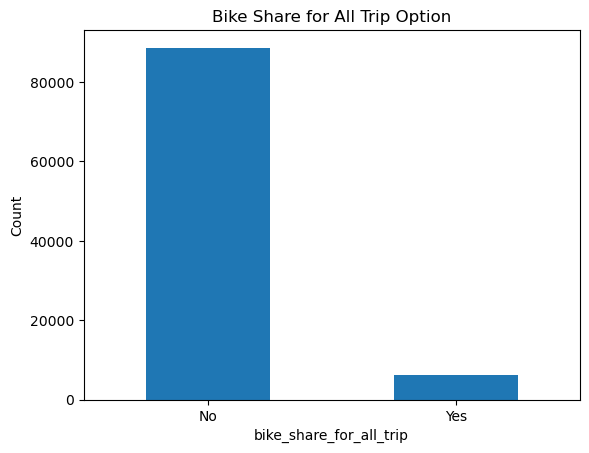

In [52]:
df['bike_share_for_all_trip'].value_counts().plot(kind='bar')
plt.title('Bike Share for All Trip Option')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.show()

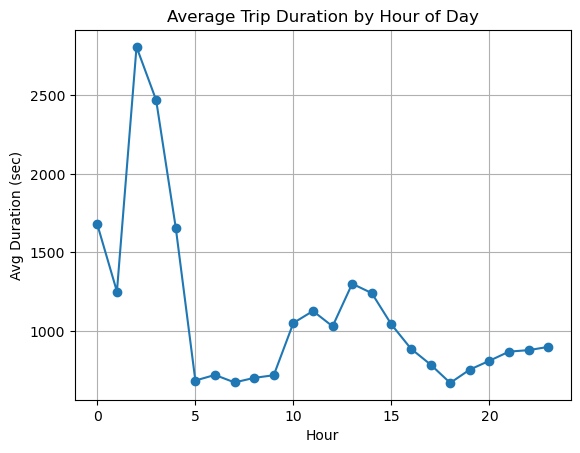

In [64]:
df['hour'] = pd.to_datetime(df['start_time']).dt.hour
df.groupby('hour')['duration_sec'].mean().plot(kind='line', marker='o')
plt.title('Average Trip Duration by Hour of Day')
plt.xlabel('Hour')
plt.ylabel('Avg Duration (sec)')
plt.grid(True)
plt.show()